In [17]:
import fastf1
from fastf1 import plotting
from matplotlib.animation import FuncAnimation
import matplotlib.pyplot as plt
from IPython.display import HTML
import numpy as np
import pandas as pd
import moviepy.editor as mp

from matplotlib import rcParams
rcParams['animation.embed_limit'] = 100

In [2]:
year = 2023
race = 'Monaco'
session_type = 'Q'
session = fastf1.get_session(year, race, session_type)
session.load()

lap = session.laps.pick_fastest()  
telemetry = lap.get_telemetry()    

req         WARNING 	DEFAULT CACHE ENABLED! (51.88 MB) C:\Users\chaud\AppData\Local\Temp\fastf1
core           INFO 	Loading data for Monaco Grand Prix - Qualifying [v3.3.9]
req            INFO 	Using cached data for session_info
req            INFO 	Using cached data for driver_info
req            INFO 	Using cached data for session_status_data
req            INFO 	Using cached data for track_status_data
req            INFO 	Using cached data for _extended_timing_data
req            INFO 	Using cached data for timing_app_data
core           INFO 	Processing timing data...
req            INFO 	Using cached data for car_data
req            INFO 	Using cached data for position_data
req            INFO 	Using cached data for weather_data
req            INFO 	Using cached data for race_control_messages
core           INFO 	Finished loading data for 20 drivers: ['1', '14', '16', '31', '55', '44', '10', '63', '22', '4', '81', '21', '23', '18', '77', '2', '20', '27', '24', '11']


In [3]:
x_coords = telemetry['X']
y_coords = telemetry['Y']

In [21]:
'''track_data = {
    'X': telemetry['X'],  
    'Y': telemetry['Y'],  
}'''

"track_data = {\n    'X': telemetry['X'],  \n    'Y': telemetry['Y'],  \n}"

In [4]:
corner_distances = [
    (200, "T1: Sainte Devote"),
    (420, "T2: Beau Rivage"),
    (780, "T3: Massenet"),
    (880, "T4: Casino"),
    (1100, "T5: Mirabeau"),
    (1225, "T6: Hairpin"),
    (1300, "T7: Mirabeau Bas"),
    (1400, "T8: Portier"),
    (1650, "T9: Tunnel Exit"),
    (2075, "T10: Nouvelle Chicane"),
    (2350, "T11: Tabac"),
    (2670, "T12: Swimming Pool"),
    (2860, "T13: Rascasse"),
    (2950, "T14: Anthony Noghes"),
]

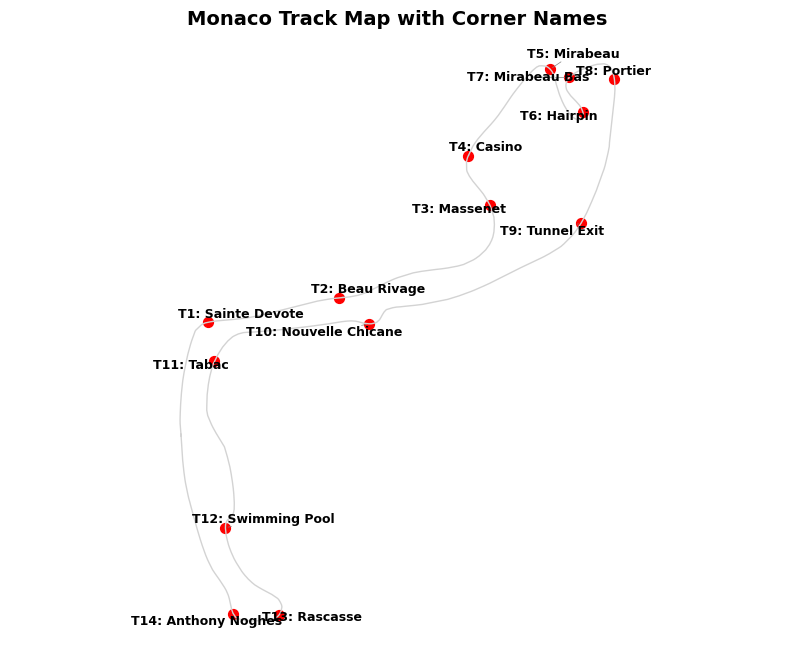

In [30]:
from adjustText import adjust_text

plt.figure(figsize=(10, 8))

# Plot the track outline
plt.plot(x_coords, y_coords, color='lightgrey', linewidth=1)  

# List to store text objects for adjustment
text_objects = []

# Plot corner markers and labels
for distance, name in corner_distances:
    corner_point = telemetry.iloc[(telemetry['Distance'] - distance).abs().idxmin()]
    
    plt.scatter(corner_point['X'], corner_point['Y'], color='red', marker='o', s=50)  
    text = plt.text(corner_point['X'], corner_point['Y'], name, fontsize=9, ha='right', color='black', weight='bold')
    
    text_objects.append(text)  # Store text objects for adjustment

# Adjust text to avoid overlap
adjust_text(text_objects, only_move={'points': 'y', 'text': 'y'}, arrowprops=dict(arrowstyle="-", color='gray', lw=0.5))

# Remove borders and axis labels
plt.gca().set_xticks([])
plt.gca().set_yticks([])
plt.gca().spines['top'].set_visible(False)
plt.gca().spines['right'].set_visible(False)
plt.gca().spines['left'].set_visible(False)
plt.gca().spines['bottom'].set_visible(False)

plt.title("Monaco Track Map with Corner Names", fontsize=14, weight='bold')
plt.axis('equal')
plt.grid(False)  

plt.savefig("monaco_track.png", dpi=300, bbox_inches="tight")
plt.show()

In [9]:
lap_alonso = session.laps.pick_driver('ALO').pick_fastest()
lap_verstappen = session.laps.pick_driver('VER').pick_fastest()

telemetry_alonso = lap_alonso.get_telemetry().add_distance()
telemetry_verstappen = lap_verstappen.get_telemetry().add_distance()

In [10]:
telemetry_alonso['Distance'] = telemetry_alonso['Distance'] / 1000 
telemetry_verstappen['Distance'] = telemetry_verstappen['Distance'] / 1000  

In [11]:
distance = min(telemetry_alonso['Distance'].max(), telemetry_verstappen['Distance'].max())
telemetry_alonso = telemetry_alonso[telemetry_alonso['Distance'] <= distance]
telemetry_verstappen = telemetry_verstappen[telemetry_verstappen['Distance'] <= distance]

In [12]:
telemetry_alonso['Time'] = telemetry_alonso['Date'] - telemetry_alonso['Date'].iloc[0]
telemetry_verstappen['Time'] = telemetry_verstappen['Date'] - telemetry_verstappen['Date'].iloc[0]

In [13]:
common_time = sorted(set(telemetry_alonso['Time']).union(set(telemetry_verstappen['Time'])))
telemetry_alonso = telemetry_alonso.set_index('Time').reindex(common_time).interpolate().reset_index()
telemetry_verstappen = telemetry_verstappen.set_index('Time').reindex(common_time).interpolate().reset_index()

C:\Users\chaud\AppData\Local\Temp\ipykernel_12948\3711795730.py:2: FutureWarning: Telemetry.interpolate with object dtype is deprecated and will raise in a future version. Call obj.infer_objects(copy=False) before interpolating instead.
  telemetry_alonso = telemetry_alonso.set_index('Time').reindex(common_time).interpolate().reset_index()
C:\Users\chaud\AppData\Local\Temp\ipykernel_12948\3711795730.py:3: FutureWarning: Telemetry.interpolate with object dtype is deprecated and will raise in a future version. Call obj.infer_objects(copy=False) before interpolating instead.
  telemetry_verstappen = telemetry_verstappen.set_index('Time').reindex(common_time).interpolate().reset_index()


In [14]:
alonso_x = telemetry_alonso['X']
alonso_y = telemetry_alonso['Y']
verstappen_x = telemetry_verstappen['X']
verstappen_y = telemetry_verstappen['Y']

In [15]:
def interpolate_telemetry(telemetry, num_points=2000):
    x_interp = np.linspace(telemetry['Distance'].iloc[0], telemetry['Distance'].iloc[-1], num=num_points)
    y_interp = np.interp(x_interp, telemetry['Distance'], telemetry['Y'])
    x_data = np.interp(x_interp, telemetry['Distance'], telemetry['X'])
    return pd.DataFrame({'X': x_data, 'Y': y_interp})

telemetry_alonso_smooth = interpolate_telemetry(telemetry_alonso)
telemetry_verstappen_smooth = interpolate_telemetry(telemetry_verstappen)

In [23]:
fig, ax = plt.subplots(figsize=(8, 6))
ax.plot(telemetry_alonso['X'], telemetry_alonso['Y'], color='lightgrey', linewidth=1, label='Track')

dot_alonso, = ax.plot([], [], 'o', color='#90EE90', label='Alonso')
dot_verstappen, = ax.plot([], [], 'o', color='#00008B', label='Verstappen')

ax.set_xlim(telemetry_alonso['X'].min() - 50, telemetry_alonso['X'].max() + 50)
ax.set_ylim(telemetry_alonso['Y'].min() - 50, telemetry_alonso['Y'].max() + 50)
ax.set_title("Monaco Lap Animation")
ax.legend()

def update(frame):
    if frame < len(alonso_x):
        dot_alonso.set_data(alonso_x.iloc[frame], alonso_y.iloc[frame])
    if frame < len(verstappen_x):
        dot_verstappen.set_data(verstappen_x.iloc[frame], verstappen_y.iloc[frame])
    return dot_alonso, dot_verstappen

frames = max(len(telemetry_alonso_smooth), len(telemetry_verstappen_smooth))
reduced_frames = range(0, frames, 5)
ani = FuncAnimation(fig, update, frames=reduced_frames, interval=80, blit=True)

plt.close(fig)
HTML(ani.to_jshtml()) 

In [24]:
mp4_path = "monaco_lap.mp4"
ani.save(mp4_path, writer="ffmpeg", fps=15, dpi=100)

In [27]:
clip = mp.VideoFileClip(mp4_path)
clip = clip.resize(height=500)  
gif_path = "monaco_lap.gif"
clip.write_gif(gif_path, fps=25)

plt.close(fig)

MoviePy - Building file monaco_lap.gif with imageio.
